Блок импорта

In [45]:
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.animation as animation

In [46]:
from sklearn.cluster import SpectralClustering, OPTICS, DBSCAN, KMeans, MiniBatchKMeans, Birch

In [47]:
import plotly.express as ex
import plotly.graph_objects as go

In [48]:
import tsfresh
from tsfresh import extract_features
from tqdm import tqdm_notebook as tn

In [49]:
%matplotlib # для анимации, главным образом

UsageError: unrecognized arguments: для анимации, главным образом


In [22]:
pip list

Package                       Version
----------------------------- ------------
absl-py                       0.15.0
alabaster                     0.7.12
anyio                         3.4.0
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
arrow                         1.2.2
astroid                       2.9.3
astunparse                    1.6.3
async-generator               1.10
atomicwrites                  1.4.0
attrs                         21.3.0
autopep8                      1.6.0
Babel                         2.9.1
backcall                      0.2.0
bcrypt                        3.2.0
binaryornot                   0.4.4
black                         22.1.0
bleach                        4.1.0
blis                          0.7.5
cached-property               1.5.2
cachetools                    4.2.4
catalogue                     2.0.6
catboost                      1.0.4
certifi                       2021.10.8
cffi                          1.15.0
chardet  

В одной директории лежат папки **01, 02, 03** - сырые данные, 

**01_output, 02_output, 03_output** - картинки (тоже самое, но в нормальном расширении)

# Работа с сырыми данными #

Чтение и визуализация для img файлов, которые в виде образов

In [5]:
path = "01/"

In [6]:
def read(path):
    all_data = []
    for filename in os.listdir(path):
        with open(os.path.join(path, filename), 'r') as file:
            #print(filename[:3], filename[4:7])
            dtype = np.dtype('uint32')
            data = np.fromfile(file, dtype)
            shp = (int(filename[:3]), int(filename[4:7]))
            data = data.reshape(shp)
            all_data.append(data)

    all_data = np.array(all_data).astype('int64')
    
    new_255 = []
    for img in all_data.copy():
        norm_image = cv2.normalize(img, None, alpha = 0, beta = 255, norm_type = cv2.NORM_MINMAX, dtype = cv2.CV_32F)
        norm_image = norm_image.astype(np.uint8)
        new_255.append(norm_image)

    return np.array(new_255)

In [7]:
df_255 = read(path)

In [32]:
df_255[0]

array([[252, 251,   0, ..., 253,   0,   0],
       [  0,   2, 251, ..., 252, 251, 250],
       [131,   3,   0, ..., 252,   0, 252],
       ...,
       [  1,   1,   0, ...,   0, 252, 253],
       [252, 251, 131, ...,   2, 251, 253],
       [  0,   0,   0, ...,   2, 131, 252]], dtype=uint8)

Визуализация

In [124]:
def f(i):
    return df_255[i]
    
fig, ax = plt.subplots()

ims = []
for i in range(0, len(df_255)):
    im = ax.imshow(f(i), animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)
plt.show()

## Временные ряды ##

In [90]:
df_255.shape

(287, 245, 237)

In [8]:
time_series = df_255.reshape(287, -1).T

In [92]:
time_series.shape # для каждого из 237*245 = 58065 пикселя свой временной ряд

(58065, 287)

In [112]:
time_series[::100].shape

(581, 287)

In [116]:
time_series[0,:]

array([252, 253, 254, 254, 254, 254, 253, 253, 253, 254, 254, 254, 254,
       214, 253, 254, 254, 254, 220, 210, 205, 205, 204, 222, 214, 201,
       195, 203, 206, 195, 212, 189, 204, 206, 206, 200, 196, 204, 201,
       202, 205, 207, 208, 206, 193, 199, 200, 201, 192, 199, 192, 197,
       192, 191, 191, 187, 185, 188, 192, 198, 180, 190, 188, 184, 190,
       190, 189, 191, 193, 189, 182, 179, 182, 191, 191, 187, 193, 184,
       195, 183, 189, 186, 193, 184, 198, 184, 192, 182, 185, 182, 190,
       185, 196, 188, 189, 193, 196, 195, 186, 198, 197, 195, 200, 196,
       189, 187, 191, 190, 187, 195, 196, 198, 204, 205, 187, 205, 202,
       190, 195, 195, 209, 199, 211, 201, 199, 205, 212, 203, 205, 217,
       213, 206, 213, 205, 214, 208, 208, 215, 213, 221, 212, 215, 214,
       223, 221, 214, 223, 215, 218, 203, 224, 214, 223, 217, 221, 217,
       227, 223, 212, 216, 220, 229, 229, 217, 217, 221, 222, 229, 221,
       222, 221, 225, 216, 224, 224, 224, 234, 228, 227, 221, 22

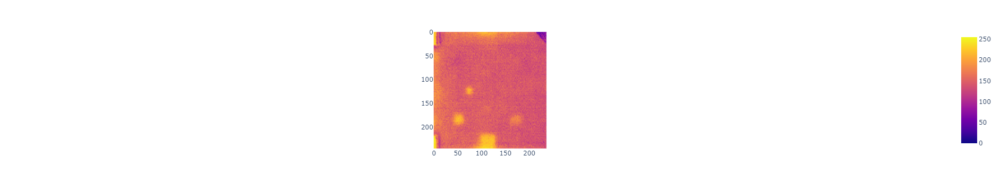

In [106]:
ex.imshow(df_255[200])

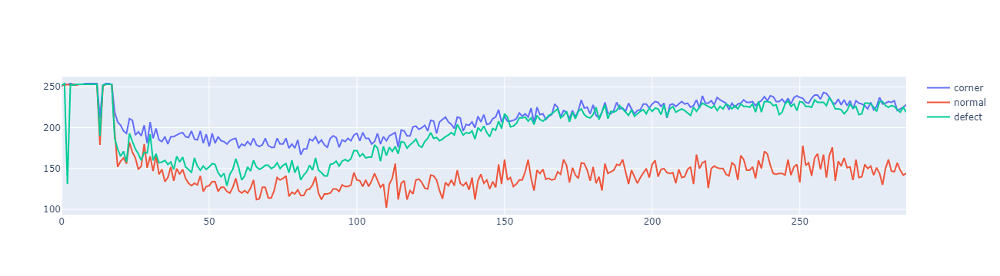

In [140]:
fig = go.Figure()
fig.add_trace(go.Scatter(y = time_series[1,:], name = 'corner'))
fig.add_trace(go.Scatter(y = time_series[23836,:], name = 'normal'))
fig.add_trace(go.Scatter(y = time_series[53446,:], name = 'defect'))

fig.show()

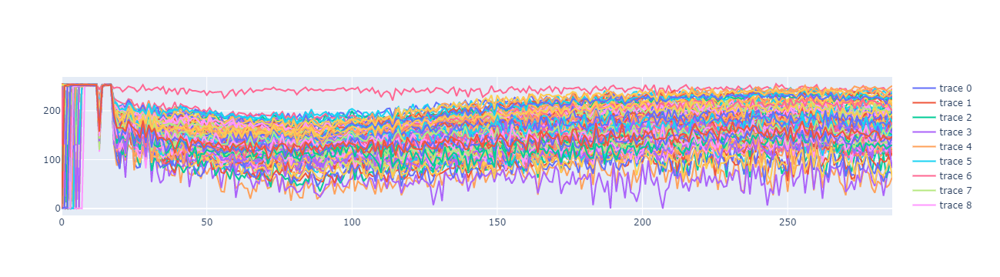

In [125]:
fig = go.Figure()
for i in range(0, len(time_series), 50):
    fig.add_trace(go.Scatter(y = time_series[i,:]))
fig.show()

## SpectralClustering ## 

In [144]:
sc = SpectralClustering(n_clusters = 2, ) # дефект/ не дефект
sc.fit_predict(time_series,)

MemoryError: Unable to allocate 25.1 GiB for an array with shape (58065, 58065) and data type float64

## MiniBatchKMeans ##

Два кластера - дефект и не дефект

In [10]:
MBKM = MiniBatchKMeans(n_clusters = 2, )
MBKM.fit_predict(time_series)

array([1, 1, 1, ..., 0, 0, 1])

In [11]:
lbls = MBKM.labels_

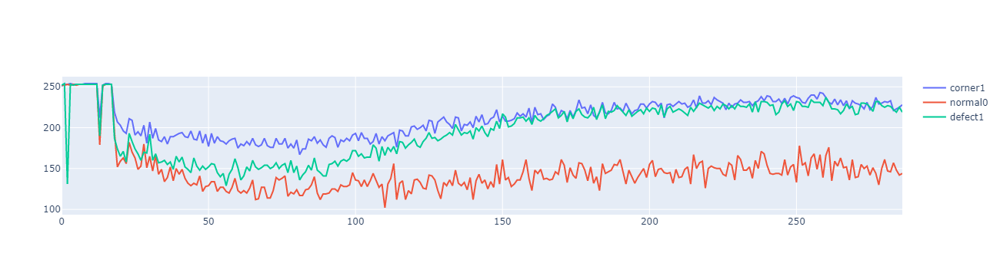

In [12]:
fig = go.Figure()
fig.add_trace(go.Scatter(y = time_series[1,:], name = 'corner' + str(lbls[1])))
fig.add_trace(go.Scatter(y = time_series[23836,:], name = 'normal' + str(lbls[23836])))
fig.add_trace(go.Scatter(y = time_series[53446,:], name = 'defect' + str(lbls[53446])))

fig.show()

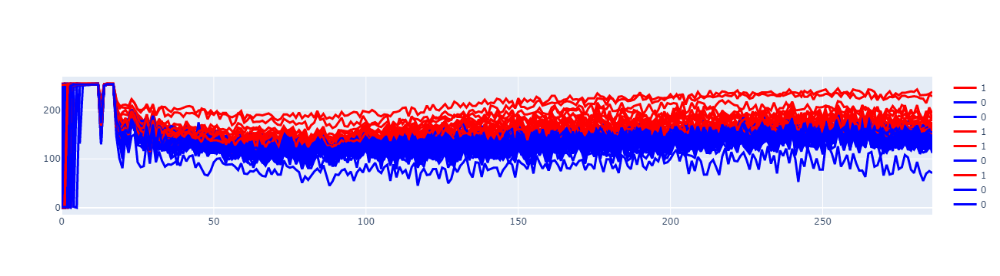

In [13]:
fig = go.Figure()
for i in range(0, len(time_series), 500):
    if (lbls[i] == 1):
        clr = 'red'
    else:
        clr = 'blue'
    fig.add_trace(go.Scatter(y = time_series[i,:], name = str(lbls[i]), line=dict(color=clr, width=3,)) )
fig.show()

Три кластера - дефект, не дефект и угловые эффекты

In [14]:
MBKM_3 = MiniBatchKMeans(n_clusters = 3, )
MBKM_3.fit_predict(time_series)

array([1, 1, 1, ..., 2, 0, 0])

In [15]:
lbls_3 = MBKM_3.labels_

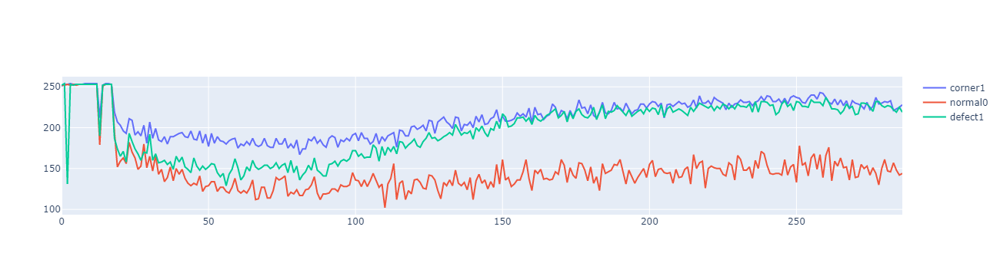

In [159]:
fig = go.Figure()
fig.add_trace(go.Scatter(y = time_series[1,:], name = 'corner' + str(lbls_3[1])))
fig.add_trace(go.Scatter(y = time_series[23836,:], name = 'normal' + str(lbls_3[23836])))
fig.add_trace(go.Scatter(y = time_series[53446,:], name = 'defect' + str(lbls_3[53446])))

fig.show()

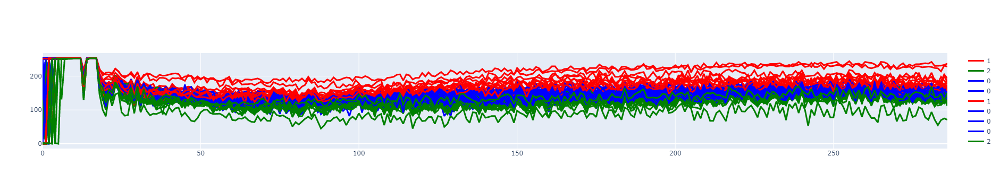

In [16]:
fig = go.Figure()
for i in range(0, len(time_series), 500):
    if (lbls_3[i] == 1):
        clr = 'red'
    elif (lbls_3[i] == 2):
        clr = 'green'
    else:
        clr = 'blue'
        
    fig.add_trace(go.Scatter(y = time_series[i,:], name = str(lbls_3[i]), line=dict(color=clr, width=3,)) )
fig.show()

## Другие методы ##

In [34]:
def use_method(method_object: object,
               time_series: np.array,
               args: tuple,
              ) -> None:
    
    model = method_object(**args)
    model.fit_predict(time_series)
    l = model.labels_
    
    fig = go.Figure()
    for i in range(0, len(time_series), 500):
        if ('n_clusters' in args.keys()):
            if (args['n_clusters'] == 3):
                #print(l[i])
                if (l[i] == 1):
                    clr = 'red'
                elif (l[i] == 2):
                    clr = 'green'
                else:
                    clr = 'blue'

                fig.add_trace(go.Scatter(y = time_series[i,:], name = str(l[i]), line=dict(color=clr, width=3,)) )

            elif (args['n_clusters'] == 2):
                if (l[i] == 1):
                    clr = 'red'
                elif (l[i] == 0):
                    clr = 'green'
                fig.add_trace(go.Scatter(y = time_series[i,:], name = str(l[i]), line=dict(color=clr, width=3,)))
            else:
                fig.add_trace(go.Scatter(y = time_series[i,:], name = str(l[i]),))
        else:
            fig.add_trace(go.Scatter(y = time_series[i,:], name = str(l[i]),))

    fig.show()

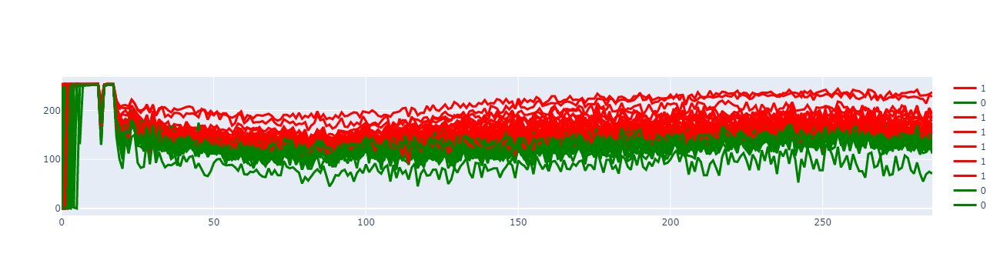

In [35]:
use_method(MiniBatchKMeans, time_series, {'n_clusters': 2})

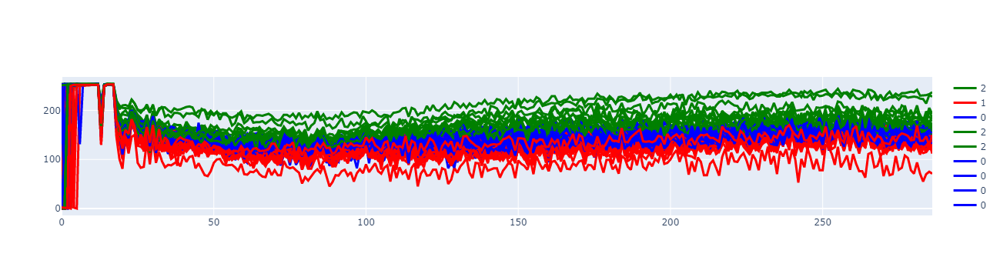

In [36]:
use_method(MiniBatchKMeans, time_series, {'n_clusters': 3})

In [33]:
use_method(SpectralClustering, time_series, {'n_clusters': 2},)

MemoryError: Unable to allocate 25.1 GiB for an array with shape (58065, 58065) and data type float64

In [37]:
use_method(OPTICS, time_series, {'n_jobs':-1})


KeyboardInterrupt



c:\python\python36\tf\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



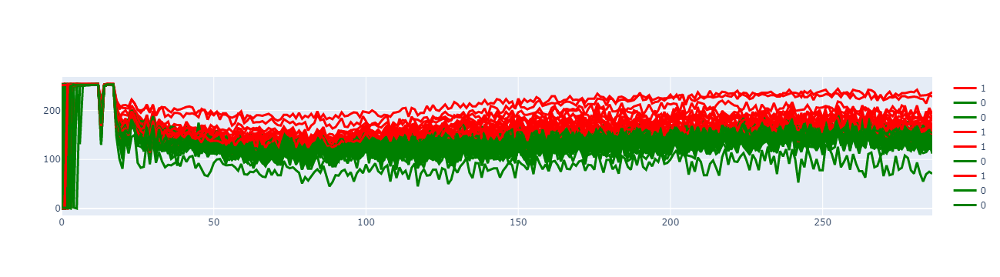

In [38]:
use_method(KMeans, time_series, {'n_jobs':-1, 'n_clusters':2})

c:\python\python36\tf\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



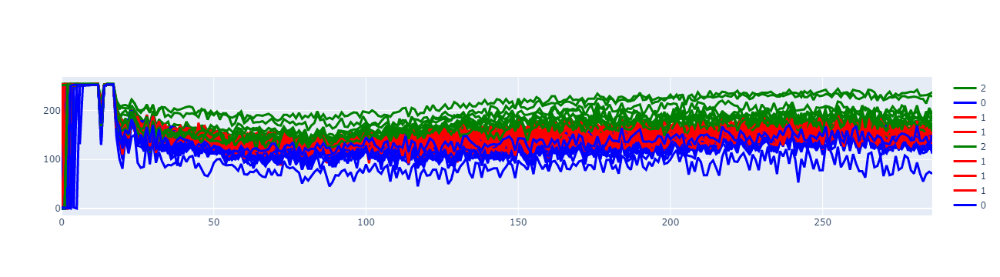

In [39]:
use_method(KMeans, time_series, {'n_jobs':-1, 'n_clusters':3},)

In [40]:
use_method(DBSCAN, time_series, {'n_jobs':-1})

KeyboardInterrupt: 

In [ ]:
Birch

c:\python\python36\tf\lib\site-packages\sklearn\cluster\_birch.py:303: RuntimeWarning:

overflow encountered in ubyte_scalars



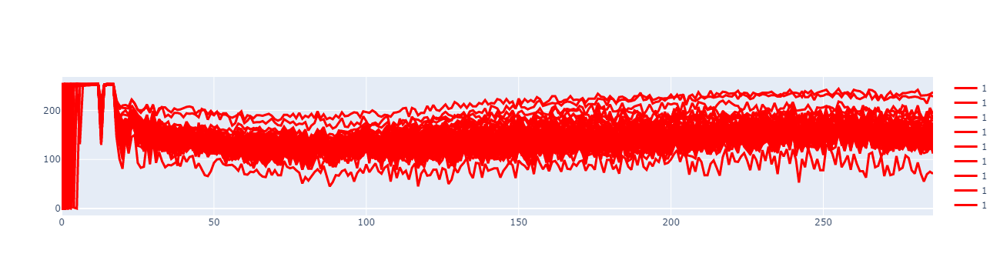

In [50]:
use_method(Birch, time_series, {'n_clusters':2, 'threshold': 0.01})

Вообще, у дефектных областей в диапазоне от 50 до 150 растет интенсивность пикселя. Возможно, проще будет посмотреть и выделить это у дифференцированного ряда.

In [133]:
time_series

array([[252, 253, 254, ..., 231, 233, 237],
       [251, 253, 253, ..., 223, 225, 228],
       [  0, 252, 253, ..., 217, 233, 234],
       ...,
       [  2,   1,   1, ..., 128, 123, 134],
       [131, 252, 252, ..., 141, 142, 147],
       [252, 252, 253, ..., 151, 156, 157]], dtype=uint8)

In [ ]:
pd.Series.diff

In [88]:
diff = pd.DataFrame(time_series.T.copy()).diff(periods = 75).dropna()

In [89]:
pd.DataFrame(time_series.T.copy())

,0,1,2,3,4,5,6,7,8,9,...,58055,58056,58057,58058,58059,58060,58061,58062,58063,58064
0,252,251,0,131,252,252,251,131,1,2,...,131,252,1,251,131,0,1,2,131,252
1,253,253,252,2,251,251,252,0,1,131,...,131,0,1,2,2,131,1,1,252,252
2,254,253,253,251,253,0,0,250,131,250,...,252,252,0,253,252,250,2,1,252,253
3,254,254,253,252,252,253,252,251,250,0,...,253,251,131,251,251,251,250,1,251,252
4,254,253,253,251,252,253,252,252,252,250,...,252,252,131,251,252,251,251,250,251,252
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,230,233,221,197,213,216,181,136,127,127,...,159,152,132,139,143,139,134,129,139,150
283,230,221,227,191,207,206,191,157,133,138,...,148,138,128,135,141,135,133,138,147,151
284,231,223,217,201,217,214,185,134,115,134,...,151,140,131,131,138,134,129,128,141,151
285,233,225,233,208,220,210,186,151,130,130,...,152,142,132,151,155,148,137,123,142,156


In [90]:
diff

,0,1,2,3,4,5,6,7,8,9,...,58055,58056,58057,58058,58059,58060,58061,58062,58063,58064
75,191.0,185.0,170.0,17.0,152.0,148.0,120.0,210.0,84.0,89.0,...,246.0,133.0,119.0,117.0,248.0,129.0,117.0,110.0,248.0,148.0
76,196.0,190.0,177.0,145.0,159.0,150.0,121.0,91.0,93.0,226.0,...,2.0,133.0,129.0,128.0,128.0,255.0,124.0,119.0,134.0,145.0
77,186.0,178.0,166.0,146.0,139.0,121.0,91.0,71.0,193.0,86.0,...,126.0,107.0,103.0,119.0,120.0,119.0,102.0,94.0,120.0,134.0
78,197.0,182.0,173.0,149.0,150.0,141.0,108.0,78.0,85.0,101.0,...,127.0,123.0,240.0,117.0,123.0,120.0,119.0,109.0,126.0,141.0
79,185.0,178.0,168.0,148.0,143.0,134.0,107.0,71.0,74.0,85.0,...,113.0,119.0,240.0,123.0,119.0,123.0,114.0,109.0,123.0,132.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,254.0,4.0,2.0,19.0,12.0,10.0,7.0,3.0,10.0,3.0,...,3.0,10.0,255.0,250.0,1.0,1.0,1.0,0.0,250.0,243.0
283,6.0,251.0,9.0,3.0,255.0,2.0,27.0,36.0,29.0,31.0,...,252.0,250.0,11.0,12.0,3.0,1.0,9.0,21.0,13.0,2.0
284,250.0,250.0,247.0,10.0,8.0,5.0,4.0,251.0,0.0,254.0,...,240.0,240.0,233.0,243.0,240.0,239.0,251.0,248.0,239.0,246.0
285,5.0,249.0,18.0,16.0,12.0,14.0,17.0,10.0,18.0,14.0,...,6.0,1.0,247.0,3.0,4.0,253.0,2.0,251.0,1.0,8.0


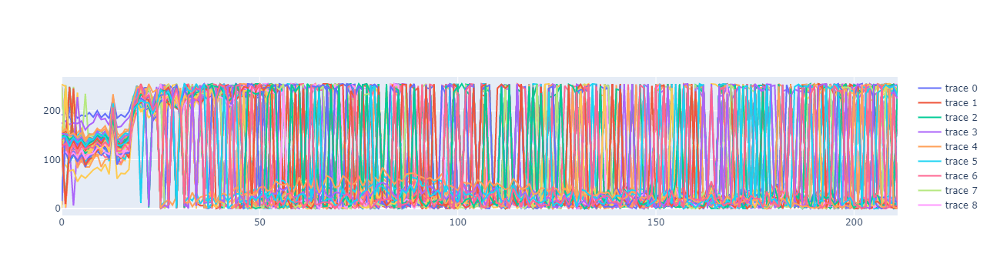

In [92]:
fig = go.Figure()
for i in range(0, diff.shape[1], 500):
    fig.add_trace(go.Scatter(y = diff[i], ))#name = str(lbls[i]), line=dict(color=clr, width=3,)) )
fig.show()

In [95]:
diff.T

,75,76,77,78,79,80,81,82,83,84,...,277,278,279,280,281,282,283,284,285,286
0,191.0,196.0,186.0,197.0,185.0,191.0,189.0,196.0,187.0,200.0,...,7.0,5.0,7.0,26.0,13.0,254.0,6.0,250.0,5.0,13.0
1,185.0,190.0,178.0,182.0,178.0,188.0,170.0,177.0,176.0,188.0,...,6.0,3.0,0.0,20.0,3.0,4.0,251.0,250.0,249.0,255.0
2,170.0,177.0,166.0,173.0,168.0,175.0,155.0,166.0,161.0,168.0,...,4.0,11.0,9.0,22.0,14.0,2.0,9.0,247.0,18.0,254.0
3,17.0,145.0,146.0,149.0,148.0,149.0,128.0,142.0,148.0,152.0,...,16.0,1.0,12.0,7.0,22.0,19.0,3.0,10.0,16.0,7.0
4,152.0,159.0,139.0,150.0,143.0,150.0,136.0,145.0,152.0,153.0,...,11.0,251.0,2.0,8.0,11.0,12.0,255.0,8.0,12.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58060,129.0,255.0,119.0,120.0,123.0,124.0,112.0,112.0,128.0,140.0,...,3.0,13.0,239.0,252.0,10.0,1.0,1.0,239.0,253.0,251.0
58061,117.0,124.0,102.0,119.0,114.0,119.0,112.0,103.0,119.0,134.0,...,8.0,7.0,235.0,252.0,7.0,1.0,9.0,251.0,2.0,4.0
58062,110.0,119.0,94.0,109.0,109.0,124.0,100.0,102.0,113.0,120.0,...,3.0,4.0,239.0,5.0,9.0,0.0,21.0,248.0,251.0,6.0
58063,248.0,134.0,120.0,126.0,123.0,130.0,119.0,122.0,134.0,136.0,...,249.0,10.0,245.0,9.0,10.0,250.0,13.0,239.0,1.0,251.0


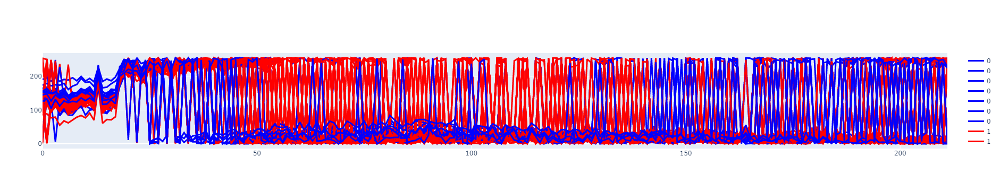

In [104]:
model = KMeans(n_clusters=2)
model.fit_predict(diff.T)
l = model.labels_

fig = go.Figure()
for i in range(0, diff.T.shape[0], 500):
    if (l[i] == 0):
        clr = 'blue'
    else:
        clr = 'red'
    fig.add_trace(go.Scatter(y = diff.T.iloc[i], name = str(l[i]), line=dict(color = clr, width=3,)) )
fig.show()

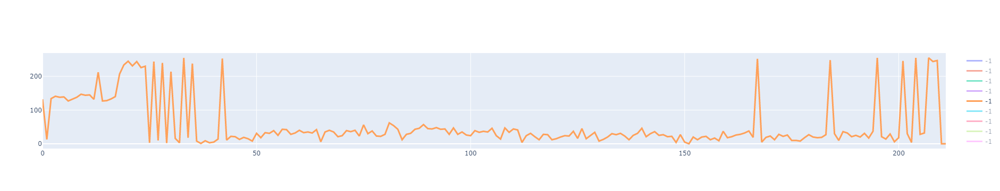

In [106]:
model = DBSCAN()
model.fit_predict(diff.T)
l = model.labels_

fig = go.Figure()
for i in range(0, diff.T.shape[0], 500):
    fig.add_trace(go.Scatter(y = diff.T.iloc[i], name = str(l[i]), line=dict( width=3,)) )
fig.show()

In [107]:
model = OPTICS()
model.fit_predict(diff.T)
l = model.labels_

fig = go.Figure()
for i in range(0, diff.T.shape[0], 500):
    fig.add_trace(go.Scatter(y = diff.T.iloc[i], name = str(l[i]), line=dict( width=3,)) )
fig.show()

KeyboardInterrupt: 

Разделение по порогу

In [109]:
diff.T

,75,76,77,78,79,80,81,82,83,84,...,277,278,279,280,281,282,283,284,285,286
0,191.0,196.0,186.0,197.0,185.0,191.0,189.0,196.0,187.0,200.0,...,7.0,5.0,7.0,26.0,13.0,254.0,6.0,250.0,5.0,13.0
1,185.0,190.0,178.0,182.0,178.0,188.0,170.0,177.0,176.0,188.0,...,6.0,3.0,0.0,20.0,3.0,4.0,251.0,250.0,249.0,255.0
2,170.0,177.0,166.0,173.0,168.0,175.0,155.0,166.0,161.0,168.0,...,4.0,11.0,9.0,22.0,14.0,2.0,9.0,247.0,18.0,254.0
3,17.0,145.0,146.0,149.0,148.0,149.0,128.0,142.0,148.0,152.0,...,16.0,1.0,12.0,7.0,22.0,19.0,3.0,10.0,16.0,7.0
4,152.0,159.0,139.0,150.0,143.0,150.0,136.0,145.0,152.0,153.0,...,11.0,251.0,2.0,8.0,11.0,12.0,255.0,8.0,12.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58060,129.0,255.0,119.0,120.0,123.0,124.0,112.0,112.0,128.0,140.0,...,3.0,13.0,239.0,252.0,10.0,1.0,1.0,239.0,253.0,251.0
58061,117.0,124.0,102.0,119.0,114.0,119.0,112.0,103.0,119.0,134.0,...,8.0,7.0,235.0,252.0,7.0,1.0,9.0,251.0,2.0,4.0
58062,110.0,119.0,94.0,109.0,109.0,124.0,100.0,102.0,113.0,120.0,...,3.0,4.0,239.0,5.0,9.0,0.0,21.0,248.0,251.0,6.0
58063,248.0,134.0,120.0,126.0,123.0,130.0,119.0,122.0,134.0,136.0,...,249.0,10.0,245.0,9.0,10.0,250.0,13.0,239.0,1.0,251.0


In [127]:
lbls = []
treshold = 25
for i in diff.T.values:
    if (np.median(i[50:150]) < treshold):
        lbls.append(1)
    else:
        lbls.append(0)

In [117]:
lbls

[1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,


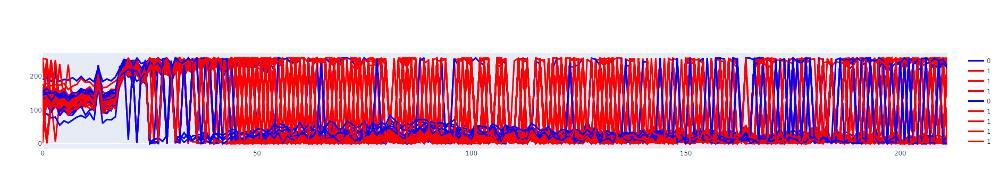

In [128]:
fig = go.Figure()
for i in range(0, diff.T.shape[0], 500):
    if (lbls[i] == 0):
        clr = 'blue'
    else:
        clr = 'red'
    fig.add_trace(go.Scatter(y = diff.T.iloc[i], name = str(lbls[i]), line=dict( color = clr, width=3,)) )
fig.show()

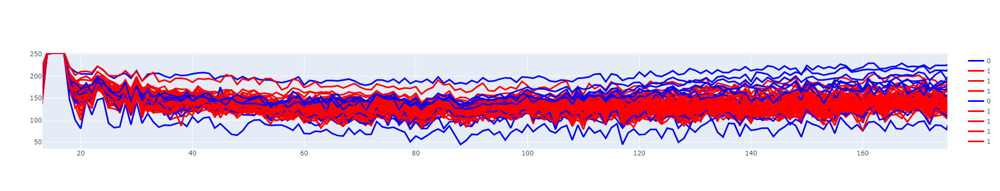

In [129]:
fig = go.Figure()
for i in range(0, diff.T.shape[0], 500):
    if (lbls[i] == 0):
        clr = 'blue'
    else:
        clr = 'red'
    fig.add_trace(go.Scatter(y = time_series[i,:], name = str(lbls[i]), line=dict( color = clr, width=3,)) )
fig.show()

## Tsfresh ##

Данная библиотека генерит фичи по каждому временному ряду, но ей нужно особое представление данных

In [35]:
time_series.shape

(58065, 287)

In [36]:
temp = pd.DataFrame(time_series.T.copy())
temp

,0,1,2,3,4,5,6,7,8,9,...,58055,58056,58057,58058,58059,58060,58061,58062,58063,58064
0,252,251,0,131,252,252,251,131,1,2,...,131,252,1,251,131,0,1,2,131,252
1,253,253,252,2,251,251,252,0,1,131,...,131,0,1,2,2,131,1,1,252,252
2,254,253,253,251,253,0,0,250,131,250,...,252,252,0,253,252,250,2,1,252,253
3,254,254,253,252,252,253,252,251,250,0,...,253,251,131,251,251,251,250,1,251,252
4,254,253,253,251,252,253,252,252,252,250,...,252,252,131,251,252,251,251,250,251,252
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,230,233,221,197,213,216,181,136,127,127,...,159,152,132,139,143,139,134,129,139,150
283,230,221,227,191,207,206,191,157,133,138,...,148,138,128,135,141,135,133,138,147,151
284,231,223,217,201,217,214,185,134,115,134,...,151,140,131,131,138,134,129,128,141,151
285,233,225,233,208,220,210,186,151,130,130,...,152,142,132,151,155,148,137,123,142,156


In [37]:
count = 0
df_for_features = pd.DataFrame([], columns = ['pixel', 'time', 'pix_id'])
for _, i in zip(tn(temp.values), temp.values):
    temp = pd.DataFrame([], columns = ['pixel', 'time', 'pix_id'])
    temp['pixel'] = i.copy()
    temp['time'] = range(0, len(temp['pixel']))
    temp['pix_id'] = count
    df_for_features = pd.concat([df_for_features, temp], axis = 0, ignore_index = True)
    count += 1

c:\python\python36\tf\lib\site-packages\ipykernel_launcher.py:3: TqdmDeprecationWarning:

This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



  0%|          | 0/287 [00:00<?, ?it/s]

In [38]:
df_for_features

,pixel,time,pix_id
0,252,0,0
1,251,1,0
2,0,2,0
3,131,3,0
4,252,4,0
...,...,...,...
16664650,147,58060,286
16664651,141,58061,286
16664652,134,58062,286
16664653,147,58063,286


Представление данных получается очень громоздким, 300+ МБ csv - таблица очень сильно жрет память

#### Сохранение данных ####

In [39]:
df_for_features.to_csv('data_for_features.csv')

#### Открытие данных ####

In [6]:
df_for_features = pd.read_csv('data_for_features.csv')

#### Создание новых признаков ####

In [ ]:
extracted_features = extract_features(df_for_features, column_id = 'pix_id', column_sort = 'time', chunksize = 50, n_jobs = 6)

Feature Extraction:   0%|                               | 0/12 [00:00<?, ?it/s]

Очень много данных, долго считается

# Открытие выгруженных данных #

In [8]:
def read_output(path):
    all_data = []
    for filename in os.listdir(path):
        #with open(os.path.join(path, filename), 'r') as file:
            #print(filename[:3], filename[4:7])
            #dtype = np.dtype('uint32')
            #data = np.fromfile(file, dtype)
            #shp = (int(filename[:3]), int(filename[4:7]))
            #data = data.reshape(shp)
            data = cv2.imread(os.path.join(path, filename))
            all_data.append(data)

    return np.array(all_data)

In [9]:
data_from_output = read_output('01_output')

In [13]:
data_from_output.shape

(287, 245, 237, 3)

In [15]:
plt.imshow(data_from_output[100])

In [16]:
data_from_output[100].shape

(245, 237, 3)

To gray

In [18]:
gray_images = []
for src in data_from_output:
    image = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY )
    gray_images.append(image)
gray_images = np.array(gray_images)

In [21]:
plt.imshow(gray_images[100])